In [1]:
library(Seurat)
library(SeuratObject)
library(harmony)
library(dplyr)
library(patchwork)
library(cowplot)
library(sctransform)
library(ggplot2)
library(DoubletFinder)
library(fields)
library(parallel)
library(remotes)
library(SeuratDisk)

Loading required package: SeuratObject

Loading required package: sp


Attaching package: ‘SeuratObject’


The following objects are masked from ‘package:base’:

    intersect, t


Loading required package: Rcpp


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘cowplot’


The following object is masked from ‘package:patchwork’:

    align_plots


Loading required package: spam

Spam version 2.10-0 (2023-10-23) is loaded.
Type 'help( Spam)' or 'demo( spam)' for a short introduction 
and overview of this package.
Help for individual functions is also obtained by adding the
suffix '.spam' to the function name, e.g. 'help( chol.spam)'.


Attaching package: ‘spam’


The following objects are masked from ‘package:base’:

    backsolve, forwardsolve


Loading required package: viridisLite


Try help(fields) to get started.

In [2]:
Kaiyu_Jin_Combined_data <- readRDS('Kaiyu_Jin_Combined_data.rds')

In [3]:
Kaiyu_Jin_Combined_data

An object of class Seurat 
21595 features across 57182 samples within 1 assay 
Active assay: RNA (21595 features, 2000 variable features)
 48 layers present: counts.Sham_1, counts.Sham_2, counts.Sham_3, counts.Sham_4, counts.MI_Day_3_1, counts.MI_Day_3_2, counts.MI_Day_3_3, counts.MI_Day_3_4, counts.MI_Day_7_1, counts.MI_Day_7_2, counts.MI_Day_7_3, counts.MI_Day_7_4, counts.MI_Day_14_1, counts.MI_Day_14_2, counts.MI_Day_14_3, counts.MI_Day_14_4, data.Sham_1, scale.data.Sham_1, data.Sham_2, scale.data.Sham_2, data.Sham_3, scale.data.Sham_3, data.Sham_4, scale.data.Sham_4, data.MI_Day_3_1, scale.data.MI_Day_3_1, data.MI_Day_3_2, scale.data.MI_Day_3_2, data.MI_Day_3_3, scale.data.MI_Day_3_3, data.MI_Day_3_4, scale.data.MI_Day_3_4, data.MI_Day_7_1, scale.data.MI_Day_7_1, data.MI_Day_7_2, scale.data.MI_Day_7_2, data.MI_Day_7_3, scale.data.MI_Day_7_3, data.MI_Day_7_4, scale.data.MI_Day_7_4, data.MI_Day_14_1, scale.data.MI_Day_14_1, data.MI_Day_14_2, scale.data.MI_Day_14_2, data.MI_Day_14_3, 

Running SCTransform on assay: RNA

Running SCTransform on layer: counts.Sham_1

vst.flavor='v2' set. Using model with fixed slope and excluding poisson genes.

Variance stabilizing transformation of count matrix of size 15327 by 2036

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 2036 cells

Found 78 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 15327 genes

Computing corrected count matrix for 15327 genes

Calculating gene attributes

Wall clock passed: Time difference of 11.1742 secs

Determine variable features

Centering data matrix

Running SCTransform on layer: counts.Sham_2

vst.flavor='v2' set. Using model with fixed slope and excluding poisson genes.

Variance stabilizing transformation of count matrix of size 15465 by 2037

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 2037 cells

Found 81 ou

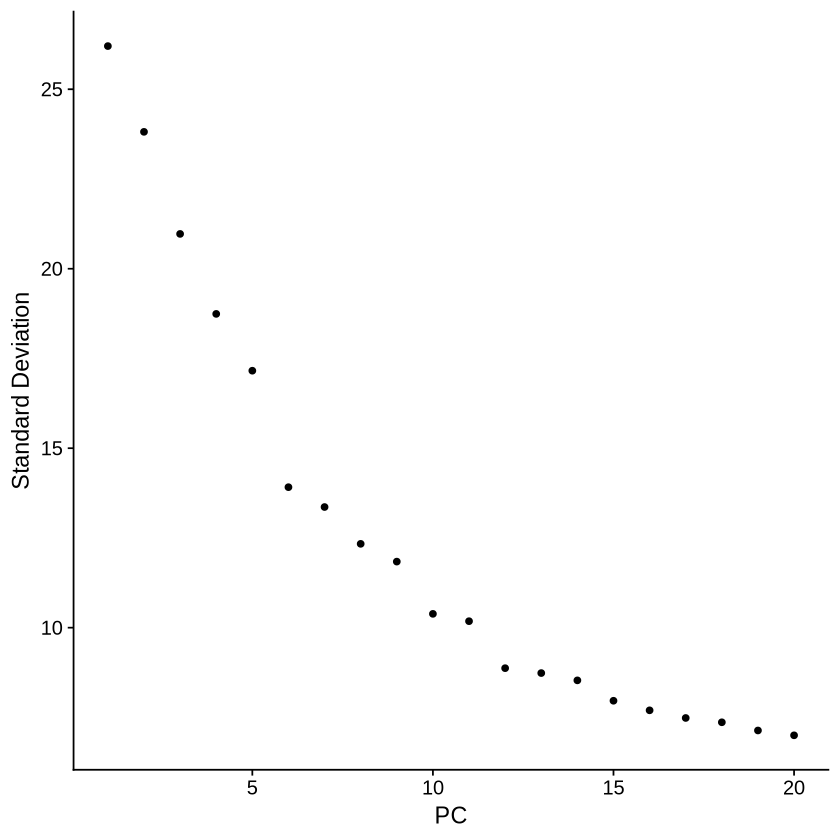

In [4]:
Combined_data_transformed<- SCTransform(Kaiyu_Jin_Combined_data)
Combined_data_transformed <- RunPCA(object = Combined_data_transformed)
ElbowPlot(Combined_data_transformed)
Combined_data_transformed <- RunUMAP(Combined_data_transformed, dims = 1:20, reduction = 'pca')

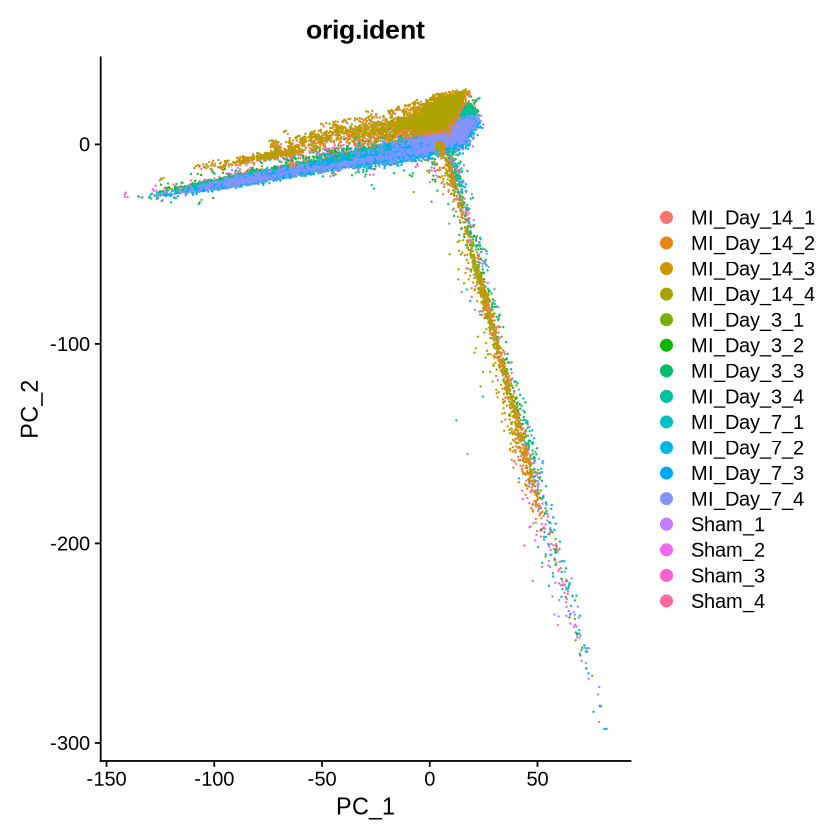

In [5]:
DimPlot(Combined_data_transformed, reduction='pca', group.by = 'orig.ident')

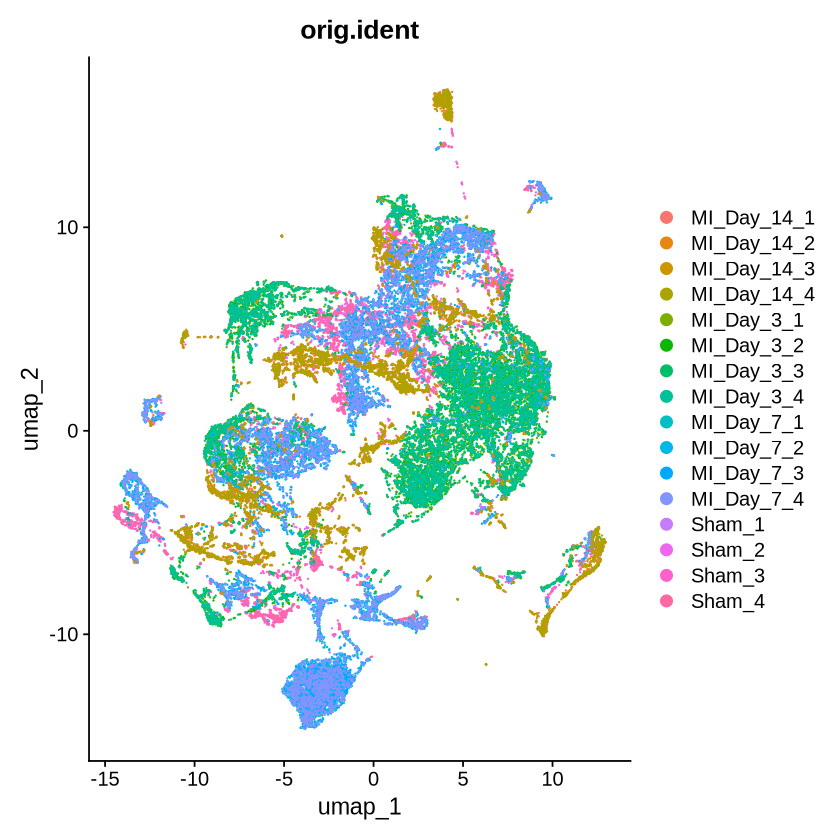

In [6]:
DimPlot(Combined_data_transformed, reduction = 'umap', group.by = 'orig.ident')

In [7]:
# Harmony
Combined_transformed.harmony <- Combined_data_transformed %>%
  RunHarmony(group.by.vars = 'orig.ident',
             plot_convergence = FALSE)
Combined_transformed.harmony@reductions

Transposing data matrix

Initializing state using k-means centroids initialization

Warning message:
“Quick-TRANSfer stage steps exceeded maximum (= 2859100)”
Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony 4/10

Harmony 5/10

Harmony 6/10

Harmony converged after 6 iterations



$pca
A dimensional reduction object with key PC_ 
 Number of dimensions: 50 
 Number of cells: 57182 
 Projected dimensional reduction calculated:  FALSE 
 Jackstraw run: FALSE 
 Computed using assay: SCT 

$umap
A dimensional reduction object with key umap_ 
 Number of dimensions: 2 
 Number of cells: 57182 
 Projected dimensional reduction calculated:  FALSE 
 Jackstraw run: FALSE 
 Computed using assay: SCT 

$harmony
A dimensional reduction object with key harmony_ 
 Number of dimensions: 50 
 Number of cells: 57182 
 Projected dimensional reduction calculated:  TRUE 
 Jackstraw run: FALSE 
 Computed using assay: SCT 


In [8]:
Combined_transformed.harmony.embed <- Embeddings(Combined_transformed.harmony, "harmony")

In [9]:
Combined_transformed.harmony <-Combined_transformed.harmony %>%
  RunUMAP(reduction = 'harmony', dims = 1:20) %>%
  FindNeighbors(reduction = 'harmony', dims = 1:20) %>%
  FindClusters(resolution = 0.5) %>%
  identity()

11:36:07 UMAP embedding parameters a = 0.9922 b = 1.112

11:36:07 Read 57182 rows and found 20 numeric columns

11:36:07 Using Annoy for neighbor search, n_neighbors = 30

11:36:07 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

11:36:14 Writing NN index file to temp file /var/tmp/pbs.9909304.pbs/RtmpriAvQZ/file2283363a3da77a

11:36:14 Searching Annoy index using 1 thread, search_k = 3000

11:36:35 Annoy recall = 96.29%

11:36:36 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

11:36:39 Initializing from normalized Laplacian + noise (using RSpectra)

11:36:45 Commencing optimization for 200 epochs, with 2452176 positive edges

11:37:11 Optimization finished

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 57182
Number of edges: 1885408

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9433
Number of communities: 25
Elapsed time: 8 seconds


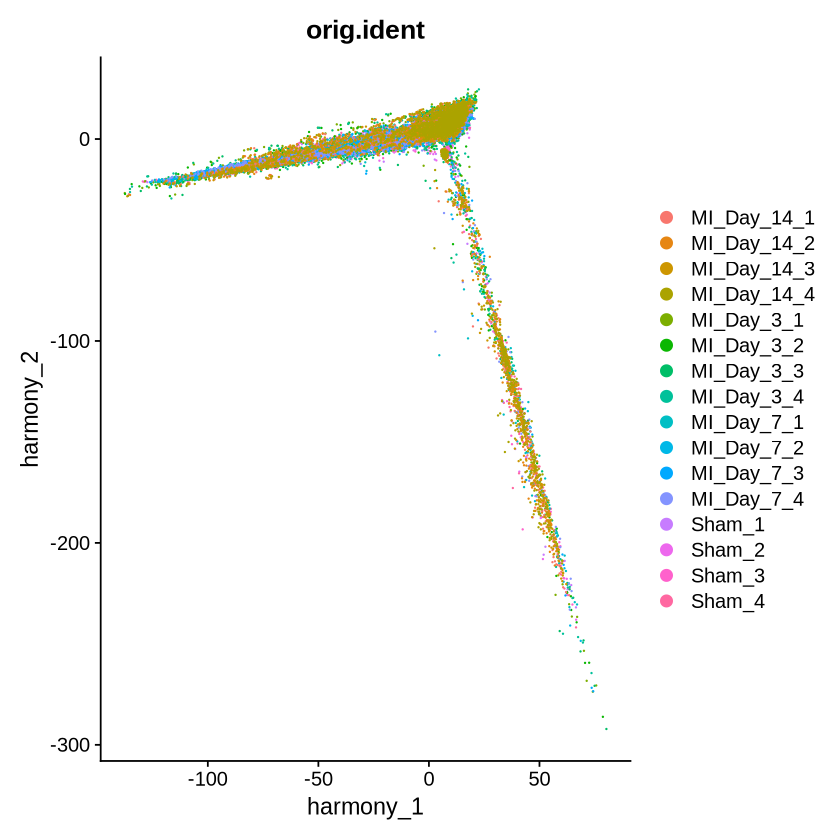

In [10]:
DimPlot(Combined_transformed.harmony, reduction = "harmony", group.by = 'orig.ident')

In [11]:
Combined_transformed.harmony <- PrepSCTFindMarkers(Combined_transformed.harmony)

Found 16 SCT models. Recorrecting SCT counts using minimum median counts: 3250



In [12]:
cluster.markers <- FindAllMarkers(Combined_transformed.harmony)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17

Calculating cluster 18

Calculating cluster 19

Calculating cluster 20

Calculating cluster 21

Calculating cluster 22

Calculating cluster 23

Calculating cluster 24



Warning message:
“The following requested variables were not found: Hbg2, Hba2, Hba1, Ftl, RNAse1, Alf1, Igfbp1”
Warning message:
“The following requested variables were not found: Hbg2, Hba2, Hba1, Ftl, RNAse1, Alf1, Igfbp1”


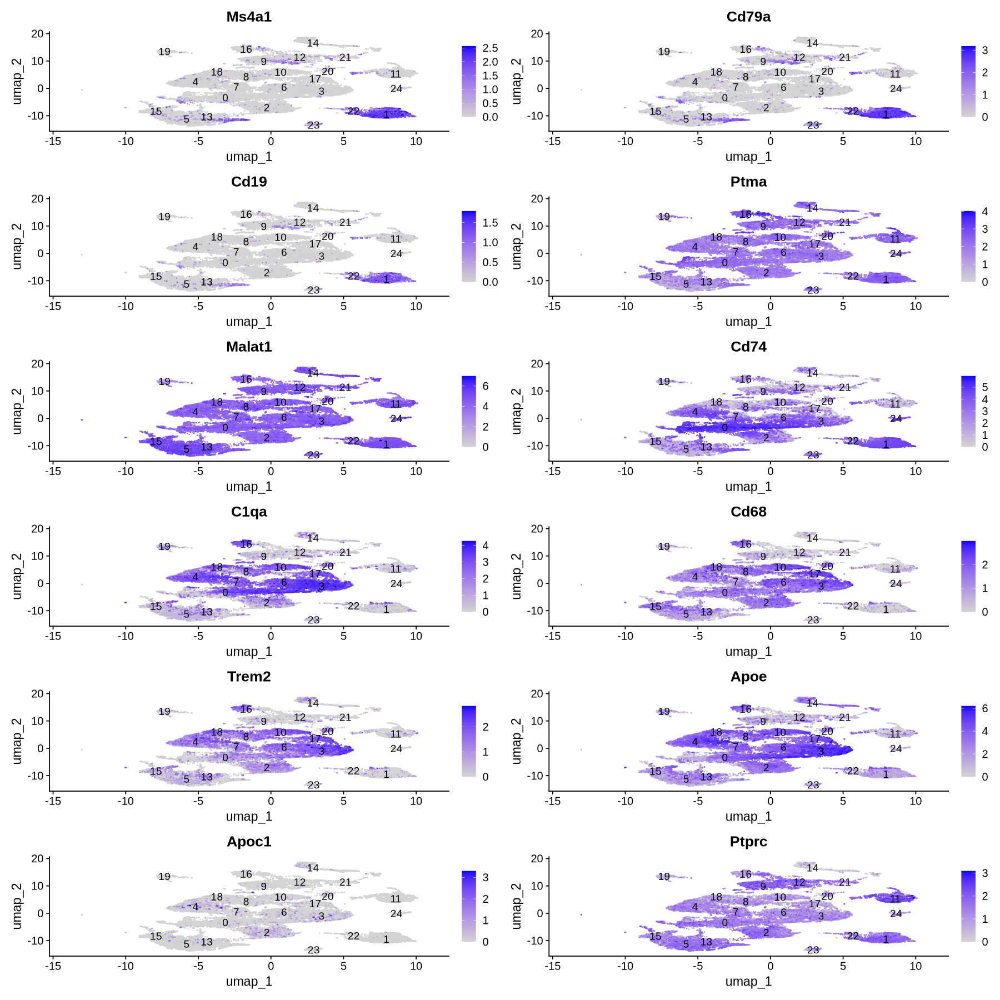

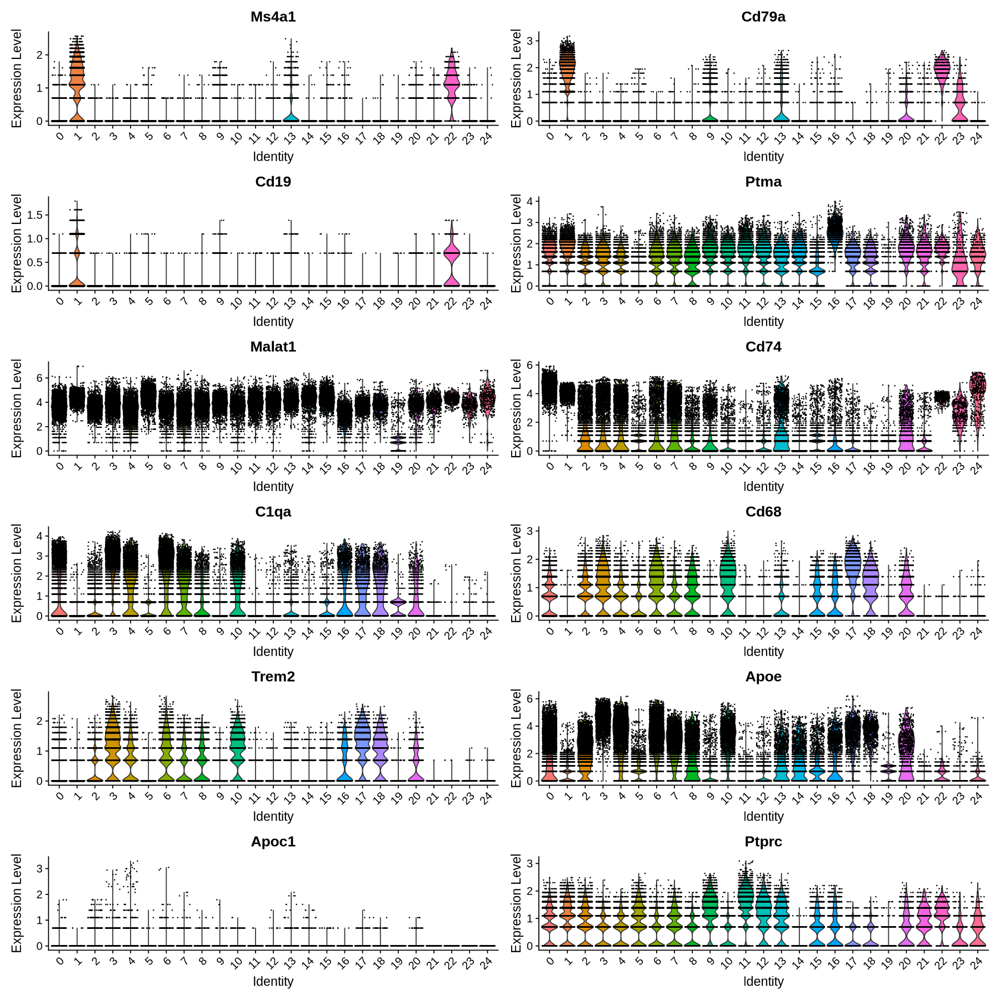

In [22]:
# B cells 1,22,9,13
#CellTypist
options(repr.plot.height = 15, repr.plot.width = 15)
markergenes=c("Ms4a1","Cd79a","Cd19", "Hbg2", "Hba2", "Ptma", "Malat1", "Hba1","Cd74", "C1qa", "Cd68","Trem2","C1qa", "Ftl", "RNAse1", "Apoe", "Alf1", "Apoc1", "C1qa", "Ptprc","Igfbp1")
FeaturePlot(object=Combined_transformed.harmony, reduction = "umap", label = TRUE, features=markergenes, order=TRUE, ncol = 2)
VlnPlot(object=Combined_transformed.harmony, features=markergenes,ncol = 2 )

Warning message:
“The following requested variables were not found: Gnly, Trdv2, Snx29P1, Linc01013”
Warning message:
“The following requested variables were not found: Gnly, Trdv2, Snx29P1, Linc01013”


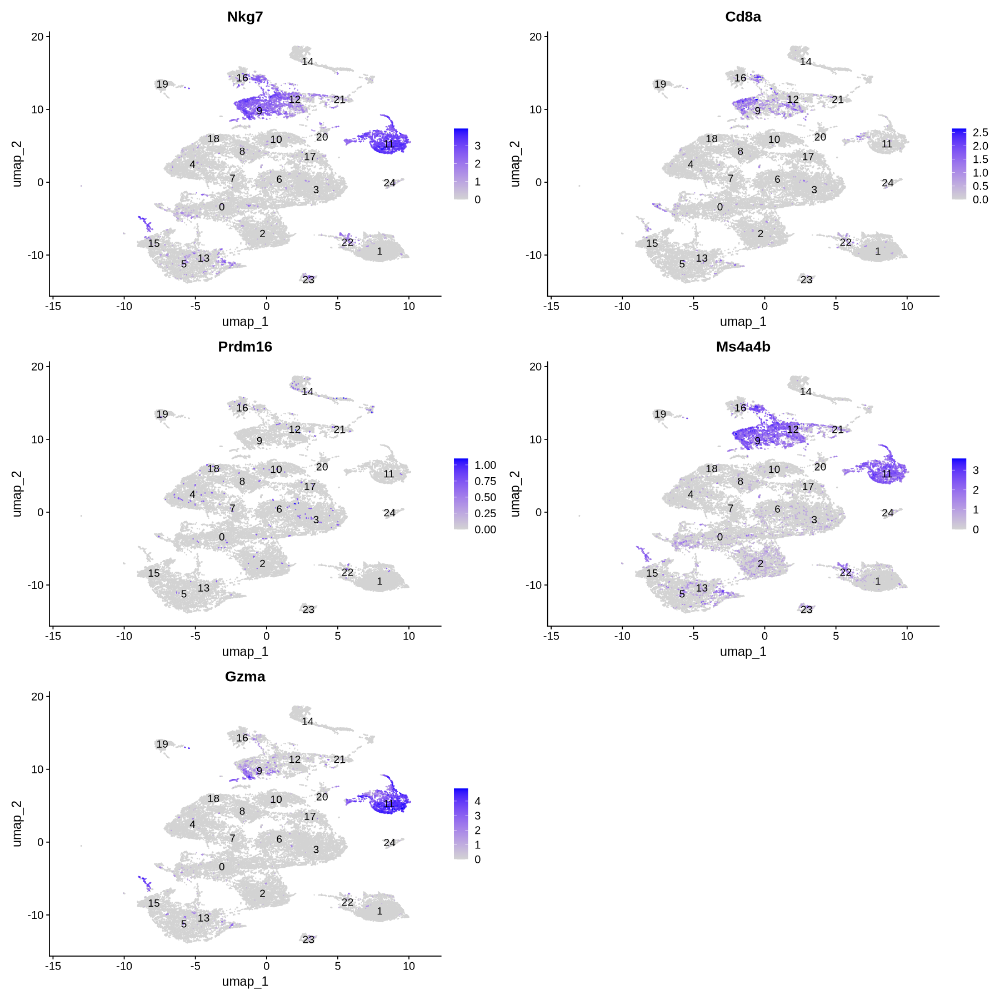

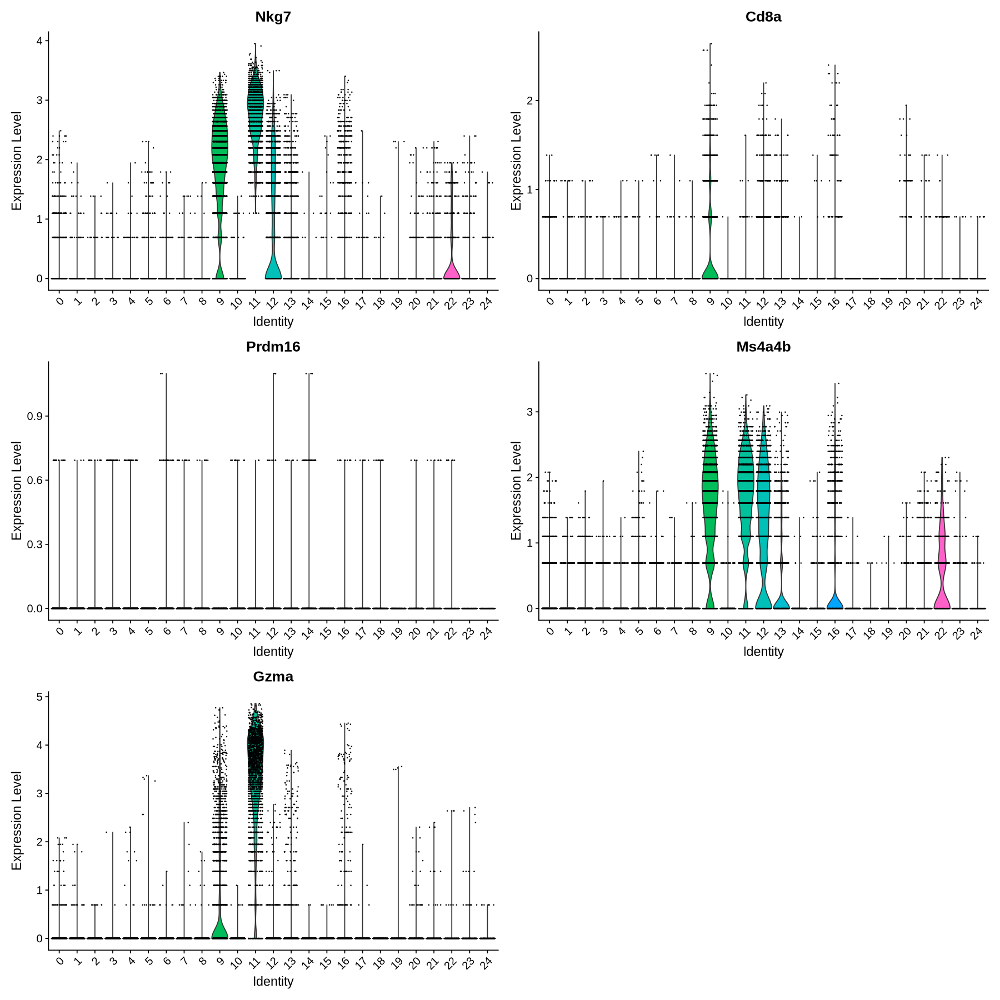

In [23]:
# T_NK Cells #9,11,12,22
#CellTypist, Forte
options(repr.plot.height = 15, repr.plot.width = 15)
markergenes=c("Nkg7","Gnly","Cd8a", "Prdm16", "Trdv2", "Snx29P1", "Linc01013", "Ms4a4b", "Gzma")
FeaturePlot(object=Combined_transformed.harmony, reduction = "umap", label = TRUE, features=markergenes, order=TRUE, ncol = 2)
VlnPlot(object=Combined_transformed.harmony, features=markergenes,ncol = 2 )

Warning message:
“The following requested variables were not found: Ftl, RNAse1, Alf1, Igfbp1”
Warning message:
“The following requested variables were not found: Ftl, RNAse1, Alf1, Igfbp1”


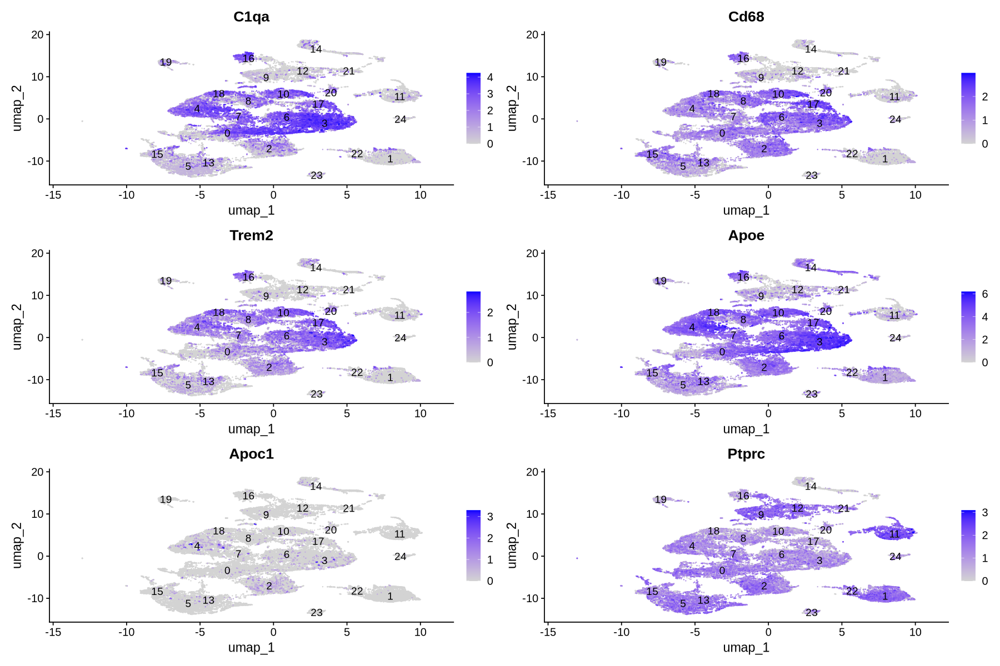

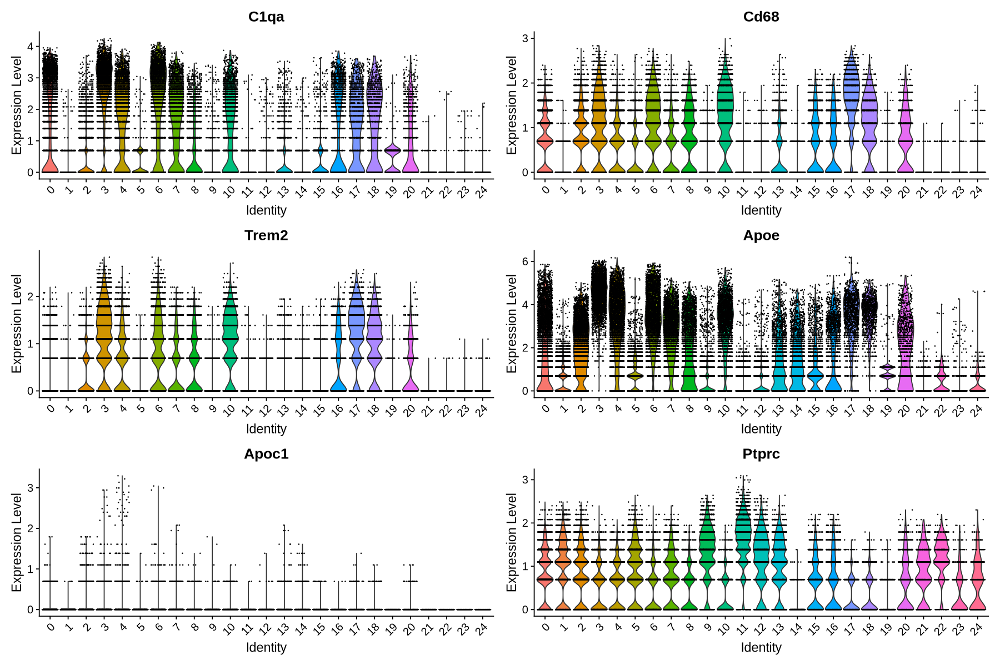

In [24]:
#Macrophages
#CellTypist
options(repr.plot.height = 10, repr.plot.width = 15)
markergenes=c("C1qa", "Cd68","Trem2","C1qa", "Ftl", "RNAse1", "Apoe", "Alf1", "Apoc1", "C1qa", "Ptprc","Igfbp1")
FeaturePlot(object=Combined_transformed.harmony, reduction = "umap", label = TRUE, features=markergenes, order=TRUE, ncol = 2)
VlnPlot(object=Combined_transformed.harmony, features=markergenes,ncol = 2 )

Warning message:
“The following requested variables were not found: Cd1c, Foxh1, H2ab1”
Warning message:
“The following requested variables were not found: Cd1c, Foxh1, H2ab1”


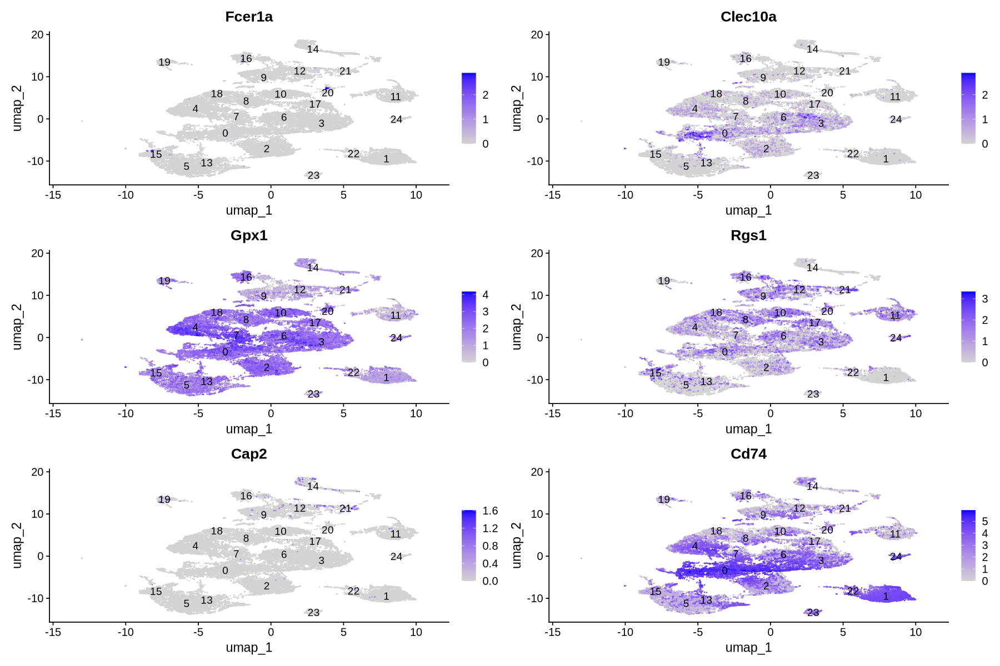

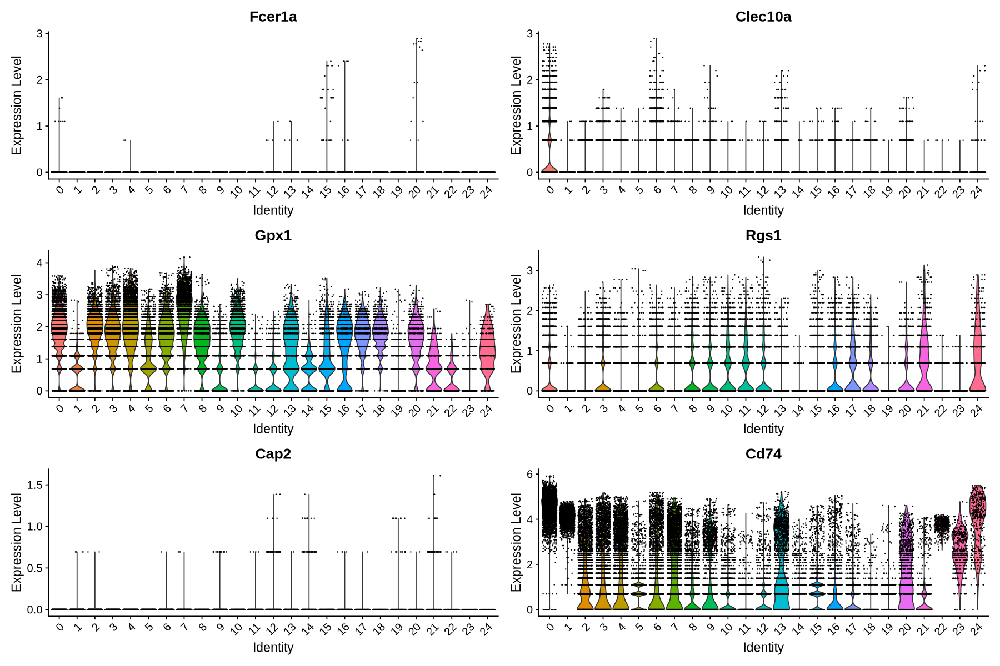

In [25]:
# DC
#CellTypist, Forte
options(repr.plot.height = 10, repr.plot.width = 15)
markergenes=c("Cd1c", "Fcer1a","Clec10a","Fcer1a", "Gpx1", "Rgs1", "Foxh1", "Cap2", "H2ab1", "Cd74")
FeaturePlot(object=Combined_transformed.harmony, reduction = "umap", label = TRUE, features=markergenes, order=TRUE, ncol = 2)
VlnPlot(object=Combined_transformed.harmony, features=markergenes,ncol = 2 )

Warning message:
“The following requested variables were not found: Ctag2, Adcyap1, Siglec17p, Rps26p8, Page5”
Warning message:
“The following requested variables were not found: Ctag2, Adcyap1, Siglec17p, Rps26p8, Page5”


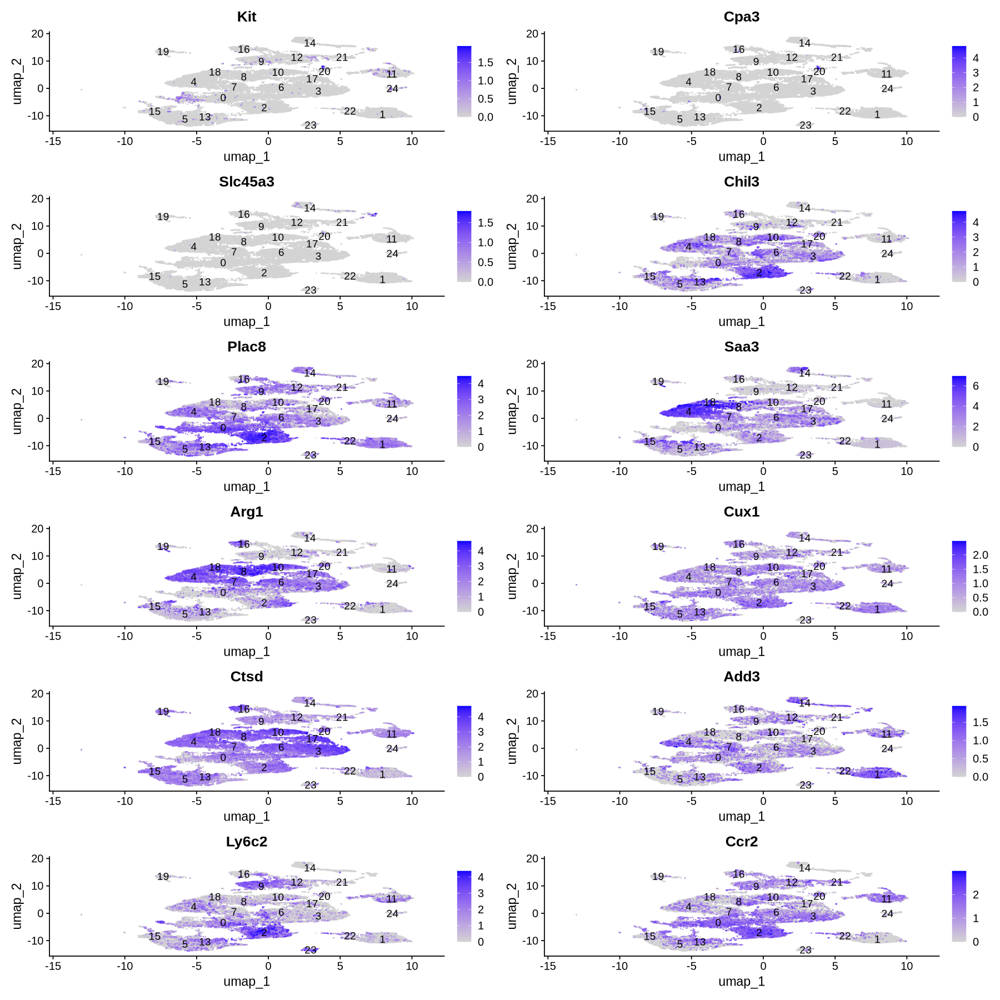

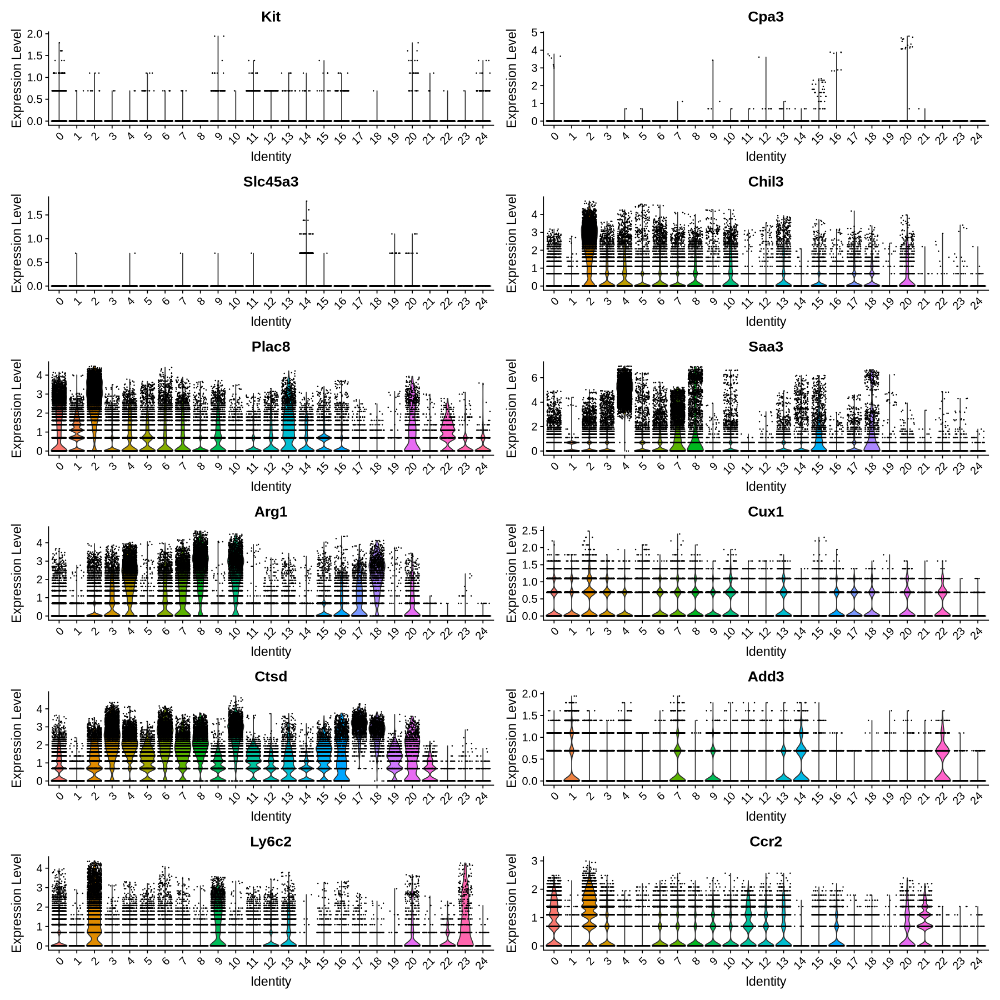

In [26]:
#Monocyte
#CellTypist, Forte
options(repr.plot.height = 15, repr.plot.width = 15)
markergenes=c("Kit", "Cpa3","Slc45a3","Ctag2", "Adcyap1", "Siglec17p", "Rps26p8", "Page5", "Chil3", "Plac8", "Saa3", "Arg1", "Cux1", "Ctsd", "Add3", "Ly6c2", "Plac8", "Ccr2")
FeaturePlot(object=Combined_transformed.harmony, reduction = "umap", label = TRUE, features=markergenes, order=TRUE, ncol = 2)
VlnPlot(object=Combined_transformed.harmony, features=markergenes,ncol = 2 )

Warning message:
“The following requested variables were not found: Lyz, Fcn1, Ftl”
Warning message:
“The following requested variables were not found: Lyz, Fcn1, Ftl”


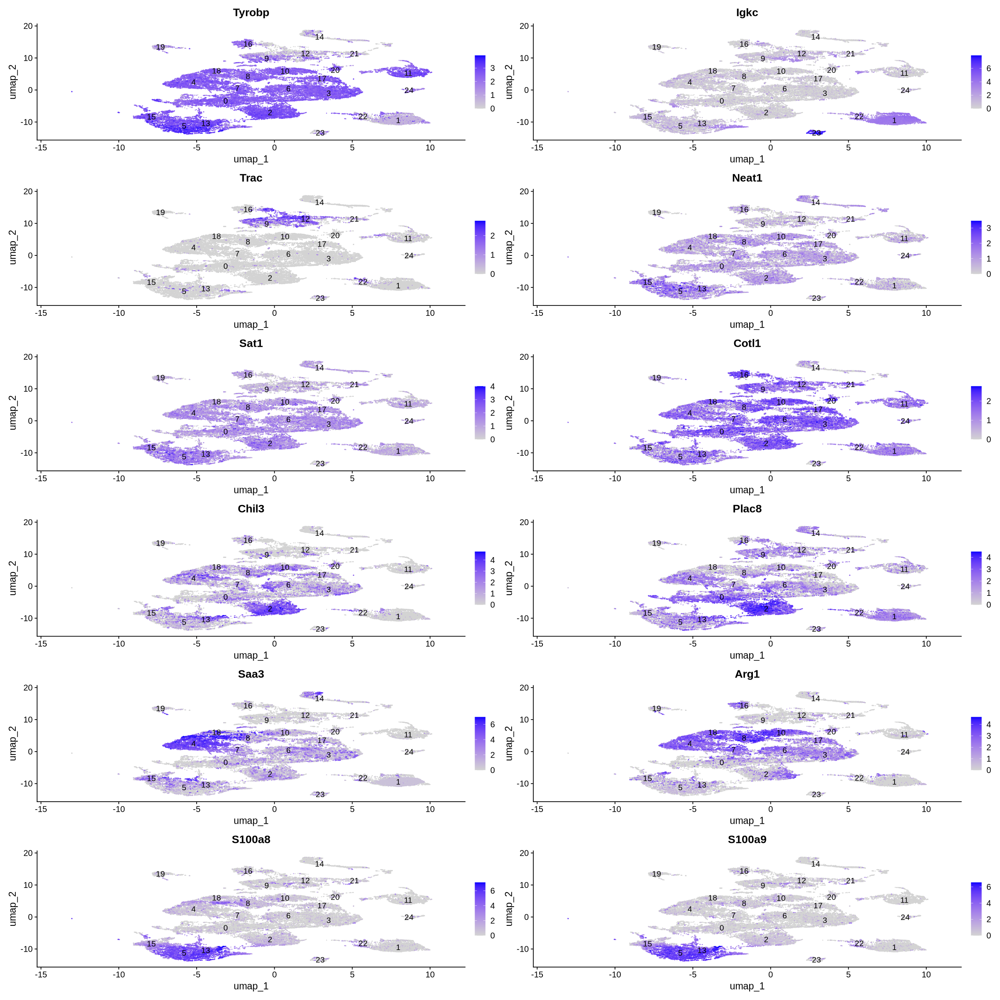

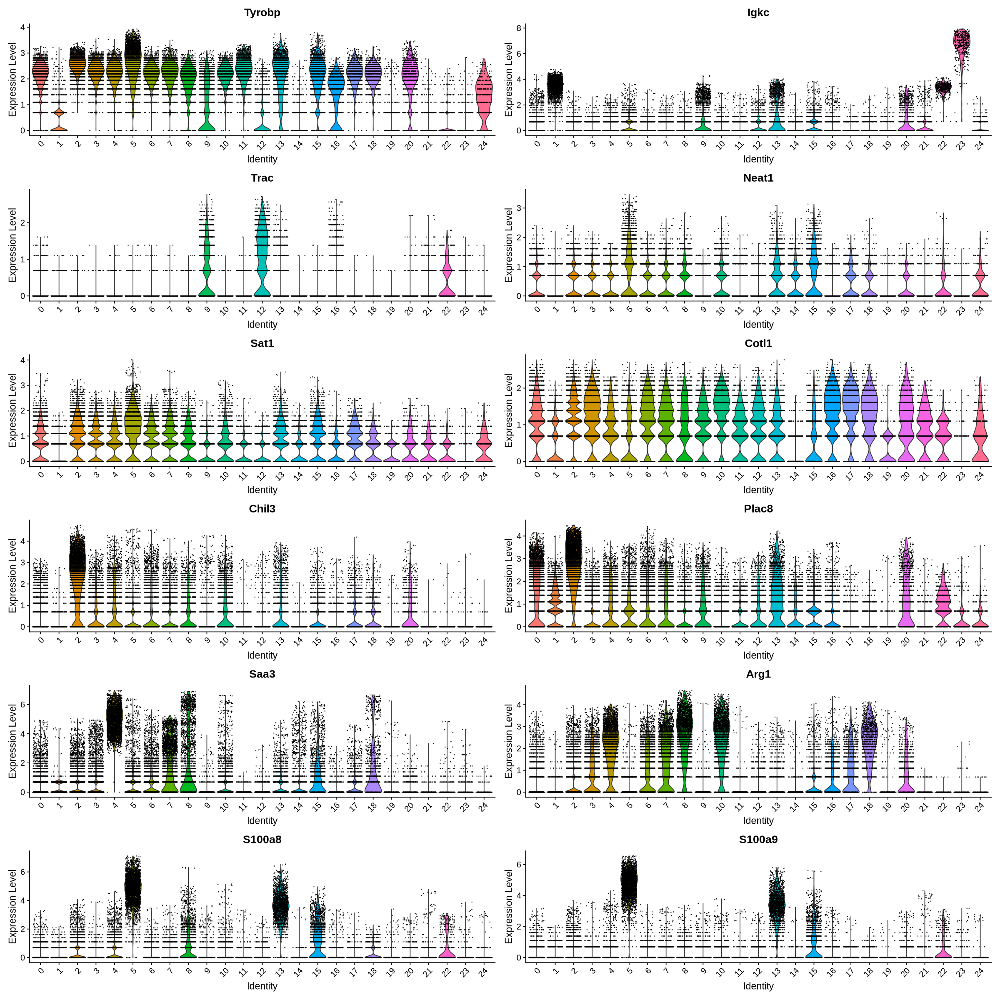

In [27]:
# Granulocyte
#CellTypist, Forte
options(repr.plot.height = 20, repr.plot.width = 20)
markergenes=c("Lyz", "Fcn1","Tyrobp","Ftl", "Igkc", "Trac", "Neat1", "Sat1", "Lyz", "Cotl1", "Chil3", "Plac8", "Saa3", "Arg1", "S100a8", "S100a9")
FeaturePlot(object=Combined_transformed.harmony, reduction = "umap", label = TRUE, features=markergenes, order=TRUE, ncol = 2)
VlnPlot(object=Combined_transformed.harmony, features=markergenes,ncol = 2 )

Warning message:
“The following requested variables were not found: Page5, Sycp1, Defa3, Ctag2”
Warning message:
“The following requested variables were not found: Page5, Sycp1, Defa3, Ctag2”


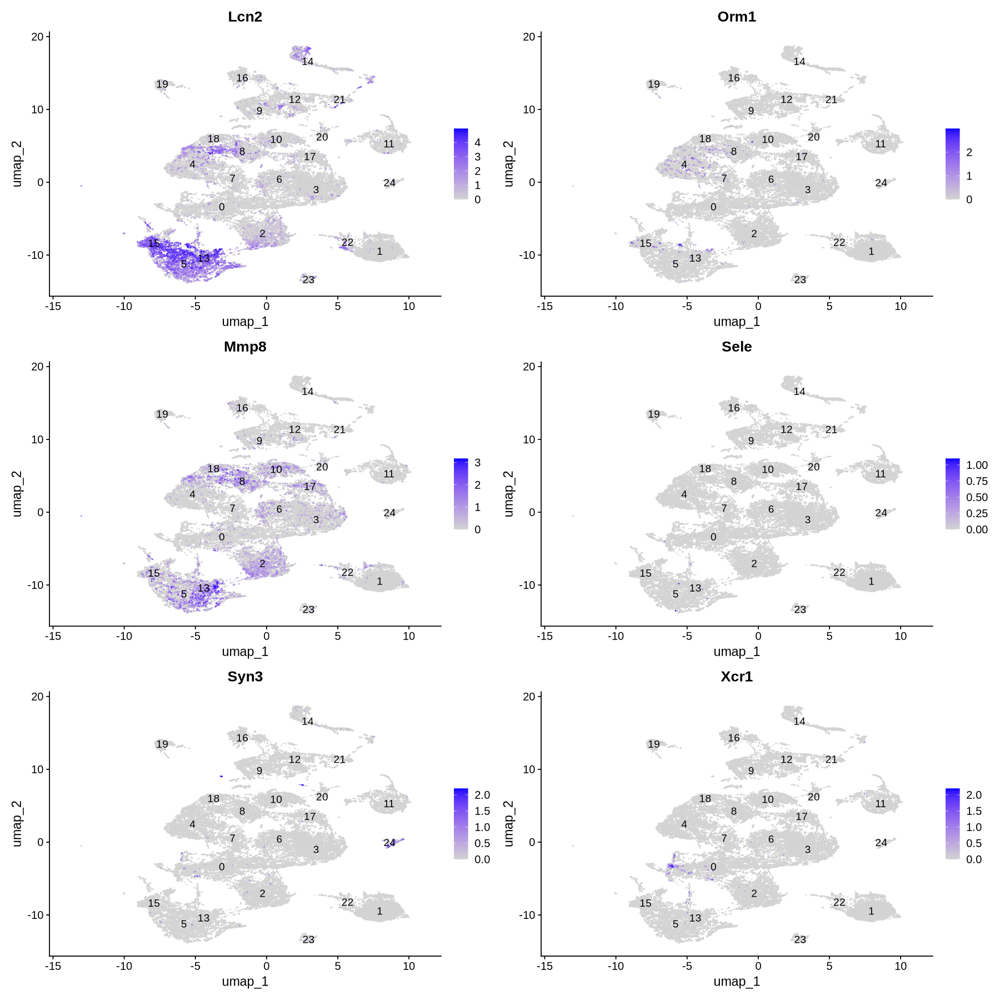

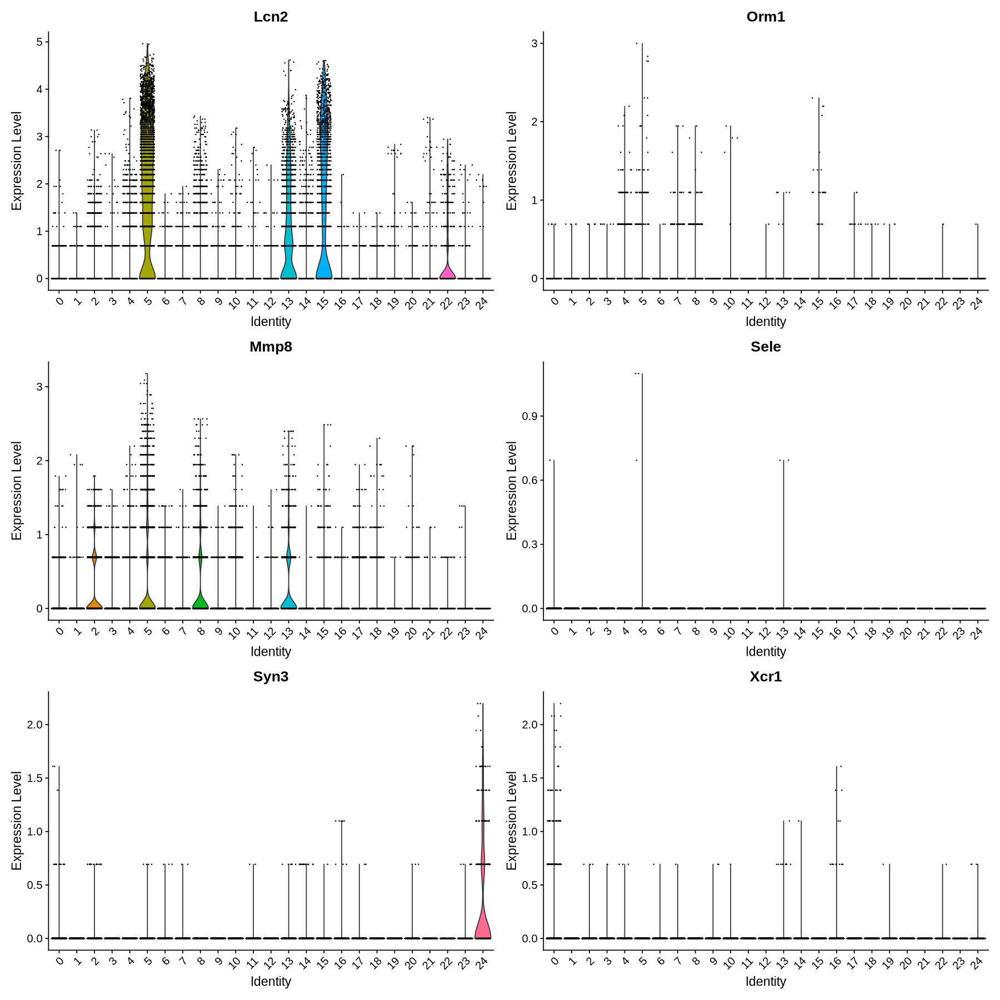

In [28]:
# Neutrophils
#CellTypist
options(repr.plot.height = 15, repr.plot.width = 15)
markergenes=c("Lcn2", "Orm1","Mmp8","Page5", "Sele", "Sycp1", "Syn3", "Xcr1", "Defa3", "Ctag2")
FeaturePlot(object=Combined_transformed.harmony, reduction = "umap", label = TRUE, features=markergenes, order=TRUE, ncol = 2)
VlnPlot(object=Combined_transformed.harmony, features=markergenes,ncol = 2 )

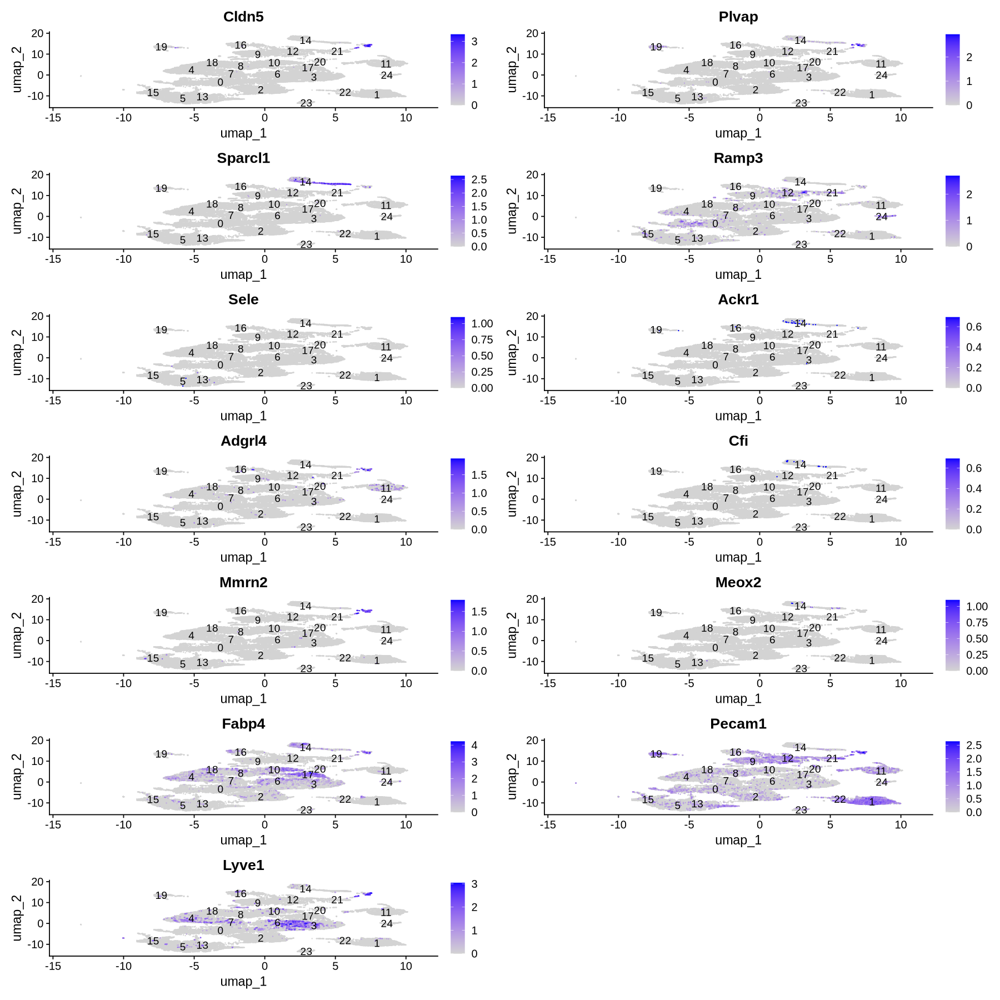

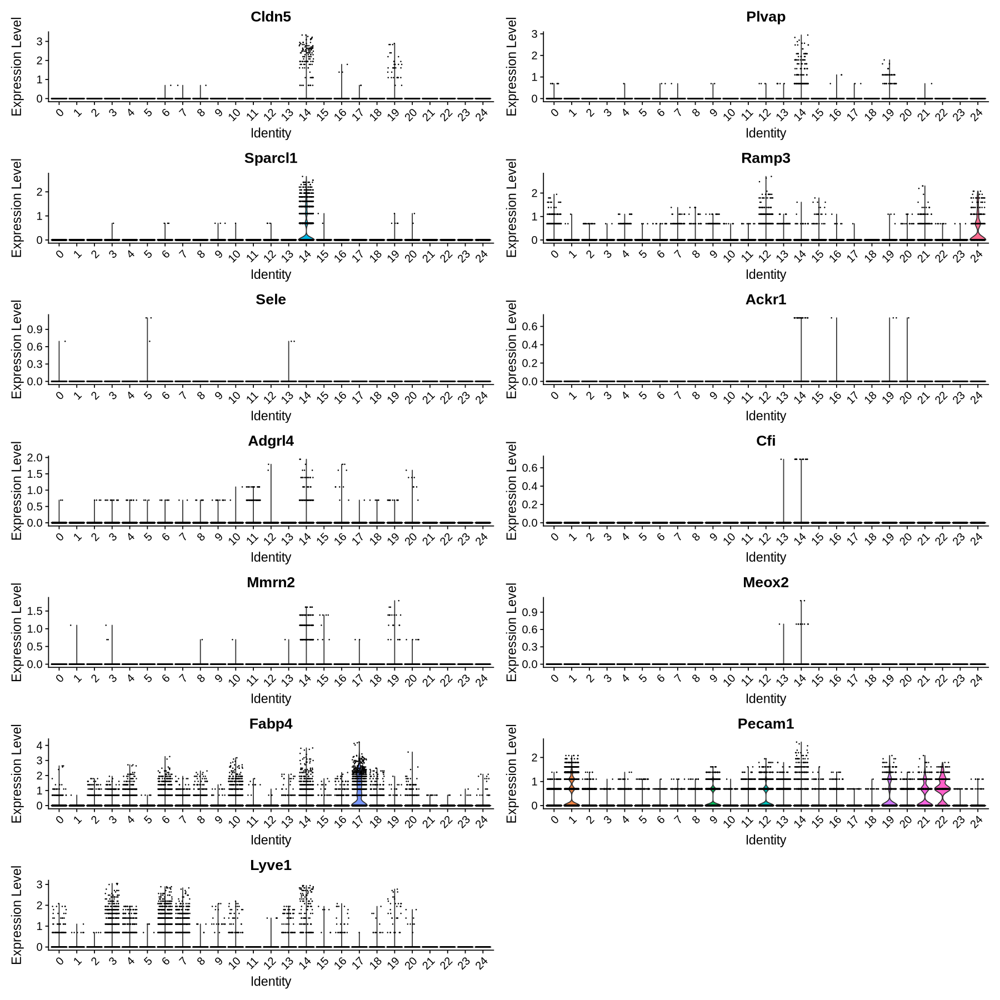

In [29]:
# Endothelial 
#CellTypist
options(repr.plot.height = 15, repr.plot.width = 15)
markergenes=c("Cldn5", "Plvap","Sparcl1","Ramp3", "Sele", "Ackr1", "Adgrl4", "Plvap", "Cfi", "Mmrn2", "Meox2", "Fabp4", "Pecam1", "Lyve1", "Cldn5")
FeaturePlot(object=Combined_transformed.harmony, reduction = "umap", label = TRUE, features=markergenes, order=TRUE, ncol = 2)
VlnPlot(object=Combined_transformed.harmony, features=markergenes,ncol = 2 )

Warning message:
“The following requested variables were not found: Mxra5”
Warning message:
“The following requested variables were not found: Mxra5”


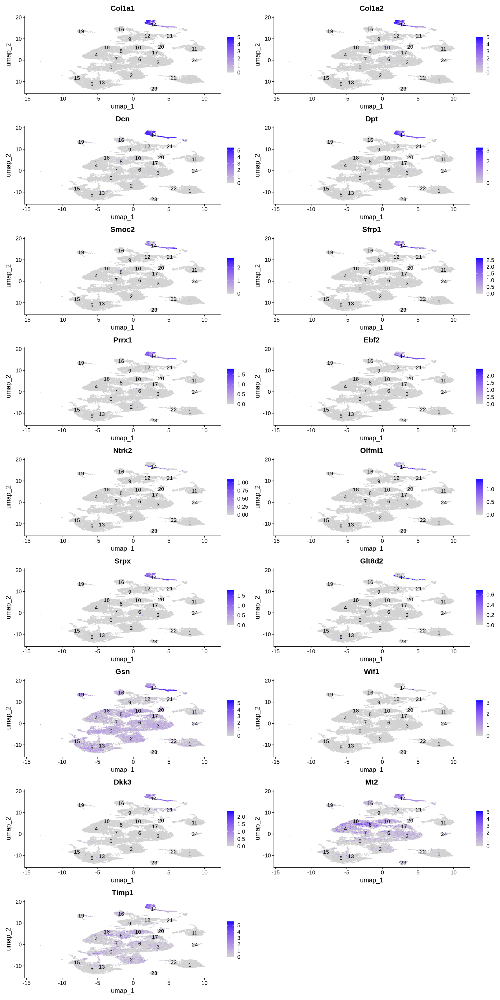

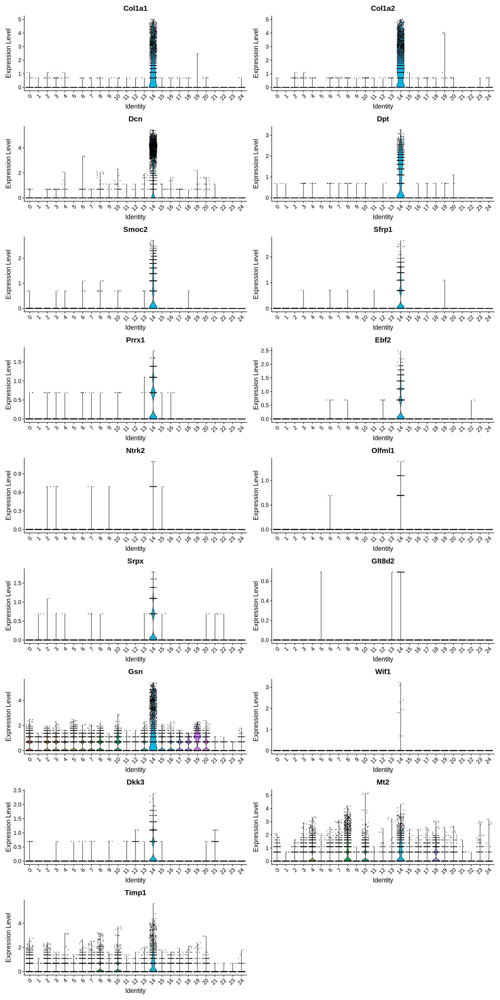

In [30]:
# Fibroblasts 14
#CellTypist
options(repr.plot.height = 30, repr.plot.width = 15)
markergenes=c("Col1a1", "Col1a2","Dcn","Dpt", "Smoc2", "Sfrp1", "Prrx1", "Mxra5", "Ebf2", "Ntrk2", "Olfml1", "Srpx", "Glt8d2", "Gsn", "Dcn", "Wif1", "Dkk3", "Mt2", "Timp1")
FeaturePlot(object=Combined_transformed.harmony, reduction = "umap", label = TRUE, features=markergenes, order=TRUE, ncol = 2)
VlnPlot(object=Combined_transformed.harmony, features=markergenes,ncol = 2 )

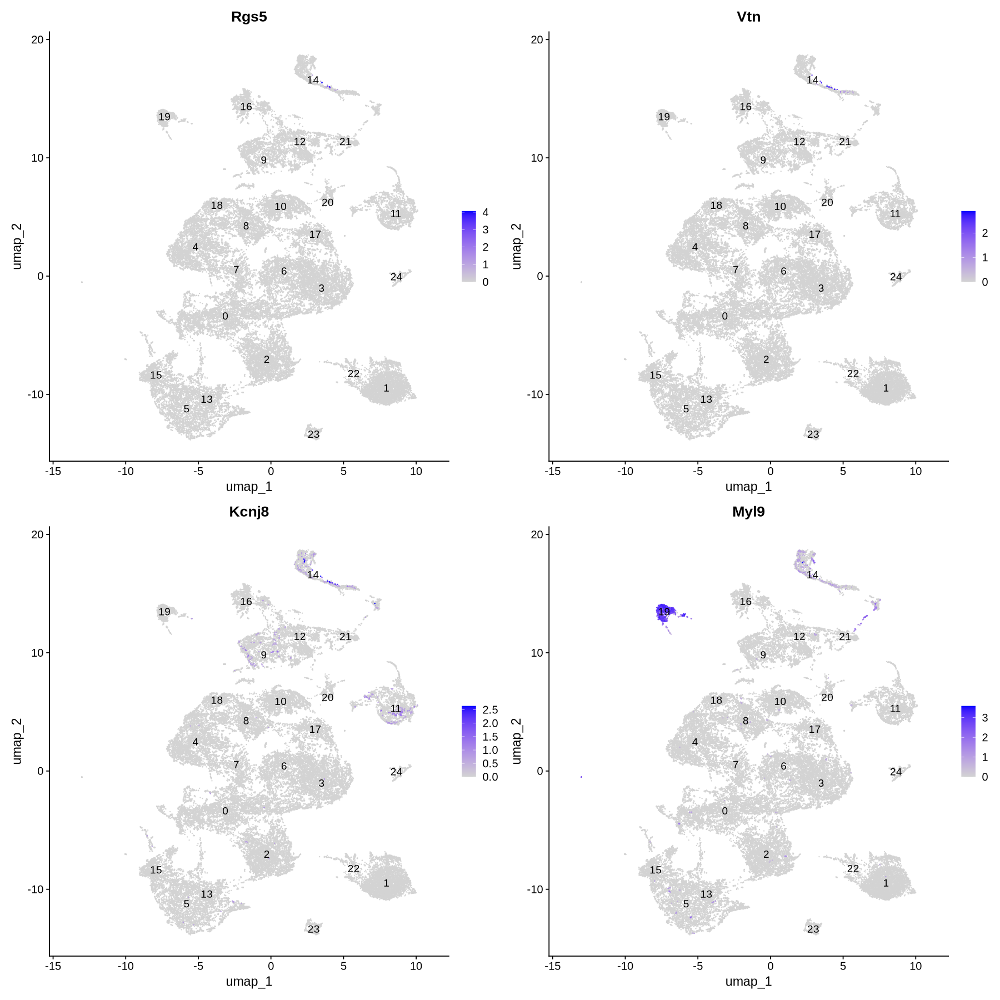

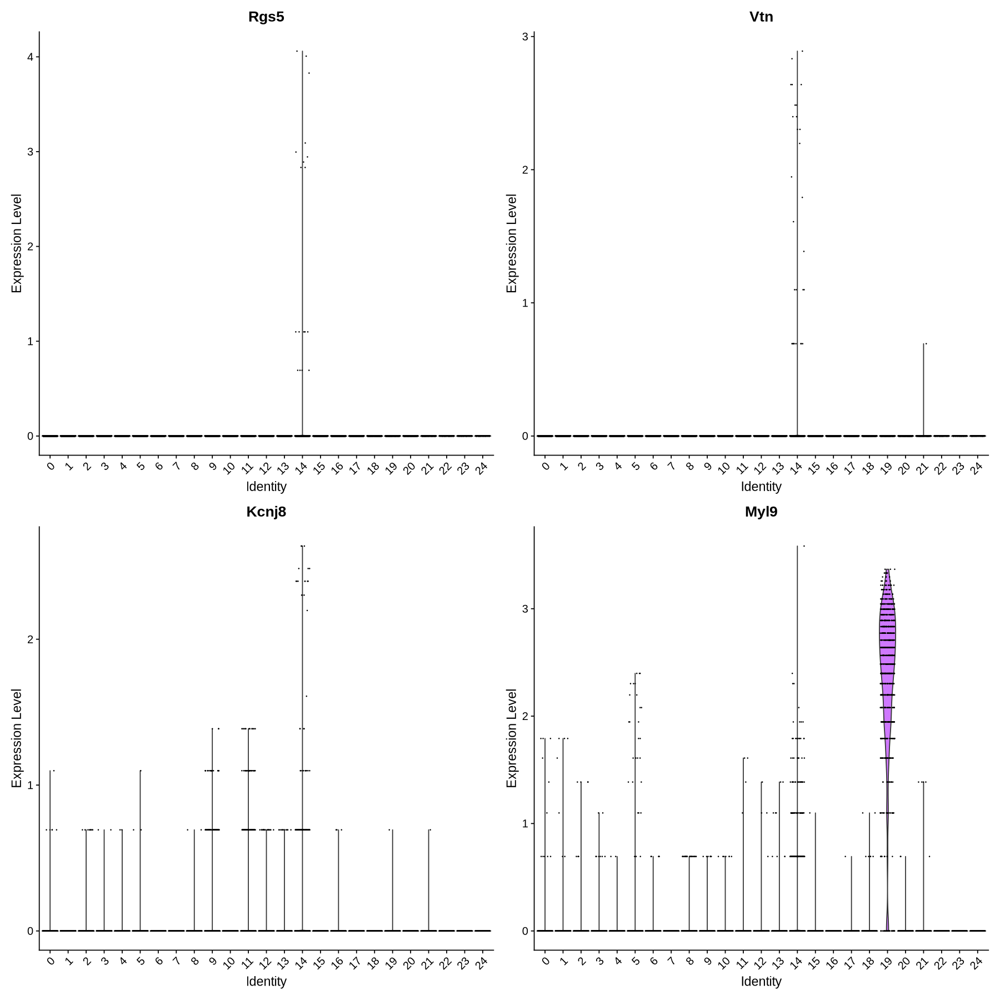

In [31]:
#SMC 19
#Forte
options(repr.plot.height = 15, repr.plot.width = 15)
markergenes=c("Rgs5", "Vtn", "Kcnj8", "Myl9")
FeaturePlot(object=Combined_transformed.harmony, reduction = "umap", label = TRUE, features=markergenes, order=TRUE, ncol = 2)
VlnPlot(object=Combined_transformed.harmony, features=markergenes,ncol = 2 )

In [13]:
new.cluster.ids <- c("Monocytes",'B_Cells','Monocytes&Granulocytes','Macrophages&Monocytes','Macrophages&Monocytes','Monocytes&Granulocytes','Macrophages','Dendritic_Cells',
                     'Macrophages','T_NK_Cells','Macrophages','T_NK_Cells','T_NK_Cells','Granulocytes','Fibroblasts','Granulocytes','Dendritic_Cells','Macrophages','Dendritic_Cells','SMC','Macrophages','Endothelial','Granulocytes','Unknown','Dendritic_Cells')
names(new.cluster.ids) <- levels(Combined_transformed.harmony)
Clusters <- RenameIdents(Combined_transformed.harmony, new.cluster.ids)

In [14]:
saveRDS(Clusters, 'KJ_Clusters.rds')